<a href="https://colab.research.google.com/github/zeeshankhalid98/20210225/blob/main/Big_Data_Analysis_on_car_Crashes_Reported_in_Montgomery_County.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Big Data Analysis on car Crashes Reported in Montgomery County

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


 **Eddy Zhang <br>
George Mason University<br>
AIT614 – Big Data Essentials<br>**


---
**Zeeshan Khalid**<br>




#Objective
Main Objective:​


*   Focus on key features integral to understand car
crashes in Montgomery County.​
*   Develop a predictive model to identify primary factors contributing to driver-at-fault incidents.​

Best Outcome:​
*   Uncover insights into root causes of car crashes.​
*   Enable targeted interventions and preventive measures for road safety enhancement.​



# Proposed Data set​

Dataset Summary:​

Title: Crash Reporting - Drivers Data​

Data Provider: Montgomery County, MD​

Update Frequency: Weekly​

Last Updated: February 9, 2024​

Dataset Description:​

The dataset provides information on motor vehicle operators (drivers) involved in traffic collisions occurring on county and local roadways within Montgomery County, Maryland. The data is collected through the Automated Crash Reporting System (ACRS) of the Maryland State Police and reported by various law enforcement agencies including the Montgomery County Police, Gaithersburg Police, Rockville Police, or the Maryland-National Capital Park Police.​

Dataset Characteristics:​

• Data points: 172,000​

• Data Features: 43



# Data Analytics Methods
Preprocessing:​

Clean and normalize data.​

Encode categorical variables.​

Exploratory Data Analysis (EDA):​

Conduct statistical analysis.​

Visualize data distributions and relationships.​

 Geospatial Analysis:​

Identify hotspots on a map.​

Feature Engineering:​

Extract time and location-based features.​

Aggregate data for summary insights.​

Predictive Modeling:​

Apply classification or regression models based on the problem.​

Models Matrix evaluation​

Report:​

Create reports and dashboards.

# Technologies ​
NoSQL database – Mongodb​

Big data Engines - Pyspark for data preprocessing and MLib for Feature Engineering and Machine learning algorithms.​

Big Data Platforms - Databricks and Jupyter Notebook​

# Data Preprocessing and preparation
Data cleaning:​
*   split date and time columns​
*   Replace 0 speed limit with mean values​
*   Replace 0 vehicle years with mode values





In [ ]:
import pandas as pd
import plotly.express as px

csv_file_path = r"/content/car_crashdata_pysparkclean (1).csv"
df = pd.read_csv(csv_file_path)

<ipython-input-8-266d0e893c67>:5: DtypeWarning:

Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.



In [ ]:
df.head(20)

,ACRS Report Type,Agency Name,Circumstance,Collision Type,Crash Date/Time,Cross-Street Name,Cross-Street Type,Date,Driver At Fault,Driver Distracted By,...,Vehicle First Impact Location,Vehicle Going Dir,Vehicle ID,Vehicle Make,Vehicle Model,Vehicle Movement,Vehicle Second Impact Location,Vehicle Year,Weather,_id
0,Property Damage Crash,Montgomery County Police,NaN,OTHER,31-05-2019 15:00,NaN,NaN,31-05-2019,Yes,UNKNOWN,...,ONE OCLOCK,North,[B@41509a37,HONDA,TK,PARKING,ONE OCLOCK,2004.0,CLEAR,660b77b8b1c52ab46467f299
1,Property Damage Crash,Gaithersburg Police Depar,NaN,STRAIGHT MOVEMENT ANGLE,21-07-2023 17:59,WATKINS MILL RD,Unknown,21-07-2023,No,NOT DISTRACTED,...,THREE OCLOCK,South,[B@46fa4738,GMC,TK,MAKING LEFT TURN,TWO OCLOCK,2011.0,CLEAR,660b77b8b1c52ab46467f29a
2,Property Damage Crash,Montgomery County Police,NaN,STRAIGHT MOVEMENT ANGLE,20-07-2023 15:10,NORBECK RD,Maryland (State),20-07-2023,Yes,NOT DISTRACTED,...,TWELVE OCLOCK,North,[B@65cf93d0,FORD,F150,ACCELERATING,TWELVE OCLOCK,2019.0,CLEAR,660b77b8b1c52ab46467f29b
3,Property Damage Crash,Montgomery County Police,NaN,STRAIGHT MOVEMENT ANGLE,23-07-2023 12:10,WATERS LANDING DR,County,23-07-2023,Yes,LOOKED BUT DID NOT SEE,...,TWELVE OCLOCK,East,[B@72d831dc,KIA,SW,STARTING FROM LANE,TWELVE OCLOCK,2016.0,CLEAR,660b77b8b1c52ab46467f29c
4,Property Damage Crash,Montgomery County Police,NaN,HEAD ON LEFT TURN,24-07-2023 06:10,CENTERWAY RD,County,24-07-2023,Yes,NOT DISTRACTED,...,TWELVE OCLOCK,North,[B@1244c5f5,TOYT,TK,MAKING LEFT TURN,TWELVE OCLOCK,2016.0,CLOUDY,660b77b8b1c52ab46467f29d
5,Property Damage Crash,Montgomery County Police,NaN,SAME DIR REAR END,11-07-2023 07:40,ALLEY,County,11-07-2023,No,NOT DISTRACTED,...,SIX OCLOCK,East,[B@3cfe6a98,GILL,BUS,STOPPED IN TRAFFIC LANE,SIX OCLOCK,2016.0,CLEAR,660b77b8b1c52ab46467f29e
6,Property Damage Crash,Montgomery County Police,"ANIMAL, N/A",SAME DIR REAR END,12-07-2023 20:28,COLESVILLE RD,US (State),12-07-2023,Yes,NOT DISTRACTED,...,TWELVE OCLOCK,South,[B@6770e193,SUBA,SW,SLOWING OR STOPPING,TWELVE OCLOCK,2014.0,CLEAR,660b77b8b1c52ab46467f29f
7,Injury Crash,Gaithersburg Police Depar,NaN,SINGLE VEHICLE,05-07-2023 23:25,STRUC #15093 GREAT SENECA CREEK,Unknown,05-07-2023,Yes,UNKNOWN,...,TWELVE OCLOCK,North,[B@783ddf1e,BMW,328I,MOVING CONSTANT SPEED,FOUR OCLOCK,2013.0,CLEAR,660b77b8b1c52ab46467f2a0
8,Property Damage Crash,Montgomery County Police,NaN,SAME DIR REAR END,21-07-2023 07:14,NW EASTERN AVE (DC MAINT),Unknown,21-07-2023,Yes,UNKNOWN,...,TWELVE OCLOCK,South,[B@3449861a,HYUNDAI,ELENTRA,STARTING FROM LANE,TWELVE OCLOCK,2020.0,CLEAR,660b77b8b1c52ab46467f2a1
9,Property Damage Crash,Montgomery County Police,NaN,SAME DIR REAR END,19-07-2023 19:00,MIDCOUNTY HWY,County,19-07-2023,Yes,INATTENTIVE OR LOST IN THOUGHT,...,TWELVE OCLOCK,North,[B@537d8531,VOLK,UT,SLOWING OR STOPPING,TWELVE OCLOCK,2022.0,CLEAR,660b77b8b1c52ab46467f2a2


# Exploratory Data Analysis

## Temporal Analysis

#### How does the relative frequency of reported crashes change over the years in the dataset?

The analysis reveals that the minimum number of reported crashes occurred in 2020, with approximately 18.5 thousand crashes, while the maximum crashes were observed in 2016, totaling around 21.77 thousand crashes. The lower number of crashes reported for 2024 is attributed to the dataset containing only three months' worth of data for that year.

In [ ]:
df['Crash Date/Time'] = pd.to_datetime(df['Crash Date/Time'], format="mixed")
df['Year'] = df['Crash Date/Time'].dt.year
crashes_by_year = df['Year'].value_counts().sort_index()
y_start = 13000
relative_crash_counts = crashes_by_year / crashes_by_year.max()
scaled_relative_counts = relative_crash_counts * (crashes_by_year.max() - y_start) + y_start
fig = px.bar(x=crashes_by_year.index, y=scaled_relative_counts,
             labels={'x': 'Year', 'y': 'Relative Frequency of Crashes'},
             title='Relative Frequency of Crashes Reported Each Year')
fig.update_layout(yaxis=dict(range=[y_start, crashes_by_year.max()]))
fig.show()

## Location-based Analysis

**What are the top 10 municipalities with the highest crash rates, and how do their frequencies compare?**


In [ ]:
# Plot the top 10 municipalities with the highest crash frequency
top_municipalities = df['Municipality'].value_counts().nlargest(10)
fig = px.bar(top_municipalities, x=top_municipalities.index, y=top_municipalities.values,
             title='Top 10 Municipalities with Highest Crash Frequency')

# Customize layout and axis titles
fig.update_layout(xaxis_title='Municipality', yaxis_title='Number of Crashes', xaxis={'categoryorder': 'total descending'})

# Show the plot
fig.show()


**Which road types have the highest number of crashes, and do specific crash types predominate on certain road types?**

Yes as evident from the data most of the crashes that happened in Montgomery County were on Maryland Interstate Road counting upto 77 thousand in last 9 years. County Route type in the second most prominent road type for crasheshing after having 55 thousand crashes.

In [ ]:
# Plot the distribution of crash types by road type
fig = px.histogram(df, x='Route Type', color='Route Type',
                   title='Distribution of Crashes by Road Type',
                   labels={'Route Type': 'Road Type', 'count': 'Count'},
                   category_orders={'Route Type': df['Route Type'].value_counts().index})
fig.update_layout(xaxis_title='Route Type', yaxis_title='Count', xaxis={'categoryorder': 'total descending'})

# Customize the appearance of the plot
fig.update_traces(marker_color='rgb(158,202,225)',
                  marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.8)

fig.show()


##Crash Severity Analysis

**Identify the most frequent injury severity level observed in the dataset. Which category of injury severity appears to be the most common?**

Analysis shows that most of the crashes drivers only suffered No aparent injury which totaled to be 141 thousand cases. While only 151 crashes resulted in Fatal Injury, which is a good news in a way.


In [ ]:
# Plot the distribution of injury severity levels
fig = px.histogram(df, x='Injury Severity', title='Distribution of Injury Severity Levels')
fig.update_layout(xaxis_title='Injury Severity', yaxis_title='Count', xaxis={'categoryorder': 'total descending'})
fig.show()

## Factors Influencing Crashes

**What are the most common weather conditions associated with reported crashes? <br> Identify the top weather conditions contributing to crash occurrences?**


Contrary to popular belief most of the crashes happened during clear weather rather than on snow or rainy days. It is because most driver are more cautioned during bad/unusual weather and are much laxed on regular sunny day.

In [ ]:
# Plot the distribution of crashes by weather condition using Plotly
fig = px.histogram(df, x='Weather', title='Distribution of Crashes by Weather Condition')
fig.update_layout(xaxis_title='Weather Condition', yaxis_title='Count', xaxis={'categoryorder': 'total descending'})
fig.show()

**Which surface conditions are most frequently associated with reported crashes? Highlight the predominant types of surface conditions contributing to crash incidents.**

 Most Crashes totally upto more than 120 thousand. Happened on Dry surface and minimum of only 4 crashes occured on sand.

In [ ]:
# Plot the distribution of crashes by surface condition
fig = px.histogram(df, x='Surface Condition', title='Distribution of Crashes by Surface Condition')
fig.update_layout(xaxis_title='Surface Condition', yaxis_title='Count', xaxis={'categoryorder': 'total descending'})
fig.show()

## Vehicle-related Analysis

**Are there any notable differences in crash involvement among the top 10 vehicle makes?**

Toyota wins this one

In [ ]:
# Plot the distribution of vehicle makes involved in crashes
top_vehicle_makes = df['Vehicle Make'].value_counts().nlargest(10)
fig = px.bar(top_vehicle_makes, x=top_vehicle_makes.index, y=top_vehicle_makes.values,
             title='Top 10 Vehicle Makes Involved in Crashes')
fig.update_layout(xaxis_title='Vehicle Make', yaxis_title='Number of Crashes', xaxis={'categoryorder': 'total descending'})
fig.show()

## Spatial Visualization

**Are there correlations between crash locations and other variables that can be explored further?**

In [ ]:
# Plot crashes on a map using Plotly
fig = px.scatter_mapbox(df, lat='Latitude', lon='Longitude', hover_name='Location',
                         title='Spatial Distribution of Crashes', zoom=10)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

## Advance Analytics:

#### In this section we will explore Relationship between Injury Severity, Vehicle Impact Location, and Collision Type:

#### How does injury severity vary across different vehicle impact locations and collision types?

In [ ]:
df_filtered = df[df['Injury Severity'].notnull() &
                 df['Vehicle First Impact Location'].notnull() &
                 df['Collision Type'].notnull()]
# Define the order of severity categories for color encoding
severity_categories = ['NO APPARENT INJURY', 'SUSPECTED MINOR INJURY', 'NON-INCAPACITATING INJURY',
                       'INCAPACITATING INJURY', 'FATAL INJURY']
# Map severity categories to numeric values for color scale
severity_mapping = {category: idx for idx, category in enumerate(severity_categories)}

# Create a scatter plot
fig = px.scatter(df_filtered, x='Vehicle First Impact Location', y='Collision Type',
                 color='Injury Severity',
                 color_discrete_map=severity_mapping,
                 labels={'Vehicle First Impact Location': 'Vehicle Impact Location',
                         'Collision Type': 'Collision Type',
                         'Injury Severity': 'Injury Severity'},
                 title='Injury Severity vs. First Impact Location and Collision Type')
fig.update_traces(marker=dict(line=dict(width=1, color='DarkSlateGrey')),
                  selector=dict(mode='markers'))

fig.update_layout(
    showlegend=True,
    legend_title='Injury Severity',
    xaxis_title='Vehicle Impact Location',
    yaxis_title='Collision Type',
    height=600, width=1000
)
fig.show()


In [ ]:
df_filtered = df[df['Injury Severity'].notnull() &
                 df['Vehicle First Impact Location'].notnull()]
# Group by both Injury Severity and Vehicle First Impact Location and count occurrences
summary_stats = df_filtered.groupby(['Injury Severity', 'Vehicle First Impact Location']).size()
#  summary statistics
print("Summary Statistics of Injury Severity by Vehicle Impact Location:")
for (severity, impact_location), count in summary_stats.items():
   print(f"Frequency of {severity} Injury with collision at {impact_location} is {count}")



Summary Statistics of Injury Severity by Vehicle Impact Location:
Frequency of FATAL INJURY Injury with collision at ELEVEN OCLOCK is 7
Frequency of FATAL INJURY Injury with collision at FOUR OCLOCK is 1
Frequency of FATAL INJURY Injury with collision at NINE OCLOCK is 5
Frequency of FATAL INJURY Injury with collision at ONE OCLOCK is 5
Frequency of FATAL INJURY Injury with collision at ROOF TOP is 1
Frequency of FATAL INJURY Injury with collision at TEN OCLOCK is 4
Frequency of FATAL INJURY Injury with collision at THREE OCLOCK is 5
Frequency of FATAL INJURY Injury with collision at TWELVE OCLOCK is 40
Frequency of FATAL INJURY Injury with collision at TWO OCLOCK is 5
Frequency of FATAL INJURY Injury with collision at UNDERSIDE is 1
Frequency of NO APPARENT INJURY Injury with collision at EIGHT OCLOCK is 1464
Frequency of NO APPARENT INJURY Injury with collision at ELEVEN OCLOCK is 5333
Frequency of NO APPARENT INJURY Injury with collision at FIVE OCLOCK is 1693
Frequency of NO APPARE

In [ ]:
df_filtered = df[df['Injury Severity'].notnull() &
                 df['Vehicle First Impact Location'].notnull()]
summary_stats = df_filtered.groupby(['Injury Severity', 'Vehicle First Impact Location']).size().reset_index(name='Frequency')
fig = px.bar(summary_stats,
             x='Vehicle First Impact Location',
             y='Frequency',
             color='Injury Severity',
             barmode='stack',
             title='Injury Severity by Vehicle Impact Location')
fig.update_layout(xaxis_title='Vehicle Impact Location',
                  yaxis_title='Frequency',
                  legend_title='Injury Severity')
fig.show()


**How does frequency of car crashes vary throughout the day?**

This  Tableau visualization showcaeses line graph illustrates the stability of a system over time, focusing on the frequency of crashes. The x-axis represents time, segmented into hourly intervals, while the y-axis displays the number of crashes recorded during each respective hour. The line depicts the trend of crash occurrences over the observed period. It is noticed that a large number of crahes have occured at 5PM during the day.

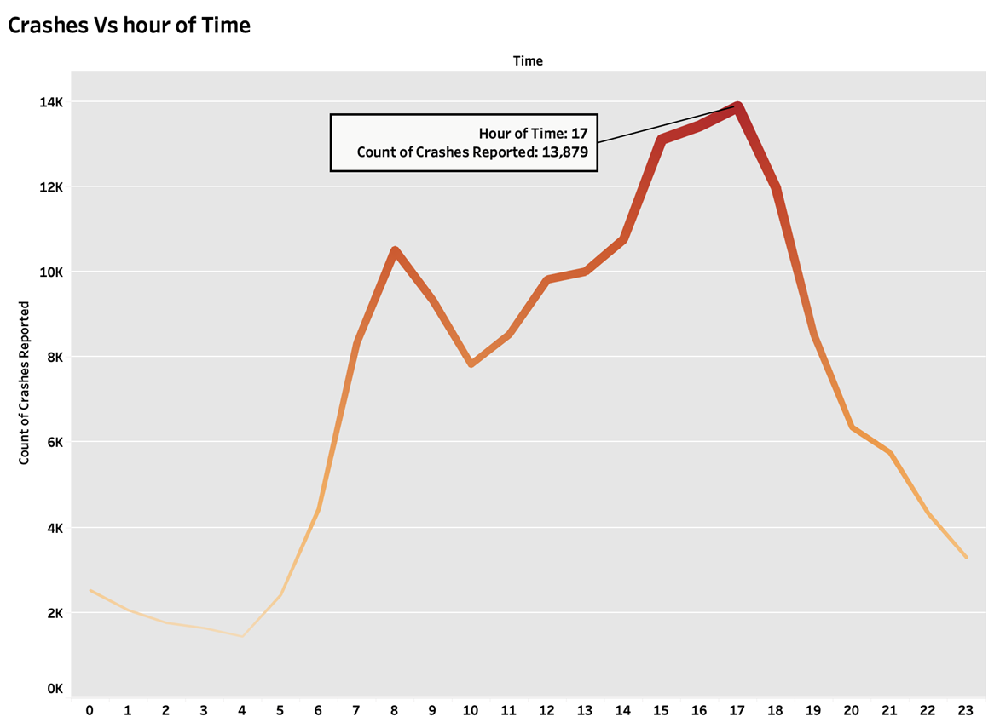

**What proportion of the injuries fall into different severity categories?**

The pie chart provides a clear and concise overview of the distribution of injuries across severity categories, enabling stakeholders to identify patterns, prioritize interventions, and make informed decisions aimed at enhancing injury prevention and management strategies. (Tableau visualization)

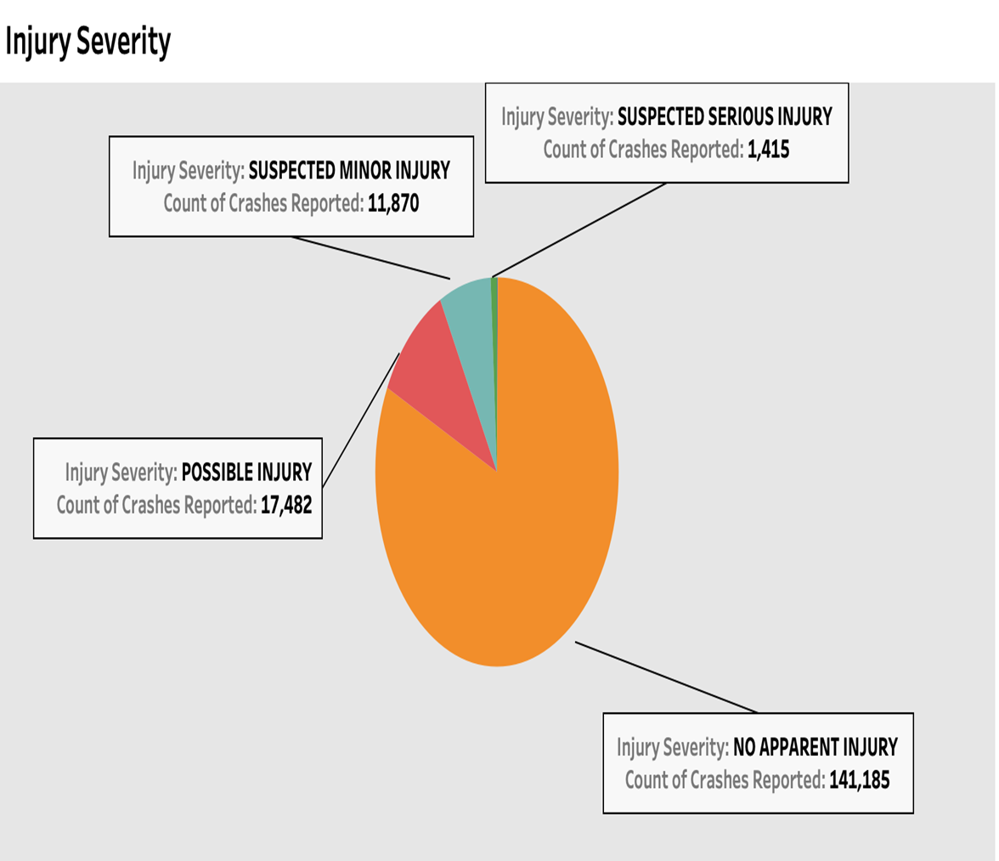

**Top vehicle types involed in car crashes**

This bar graph visualizes the frequency of different vehicle types involved in car crashes, highlighting the top categories contributing to accidents. Each bar represents a specific vehicle type, with the height of the bar corresponding to the number of car crashes involving vehicles of that type. Seems like 119,102 out of all the car crashes are Passgener cars.(Tableau visualization)

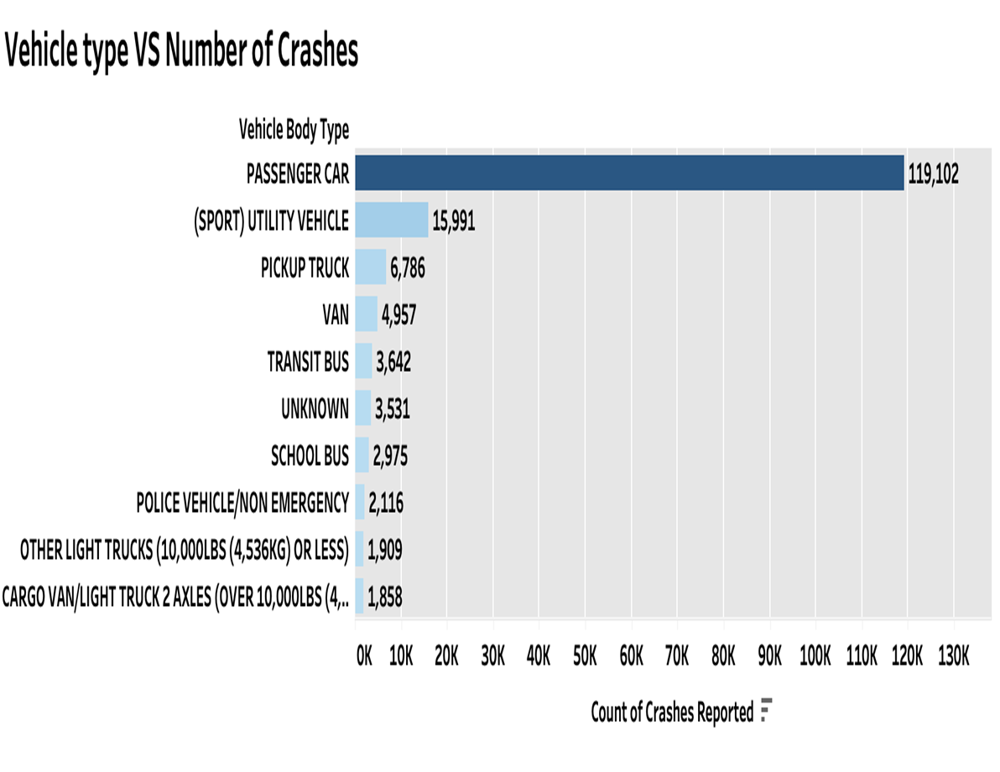

The bar graph provides valuable insights into the distribution of car crashes across various vehicle types, while also shedding light on driver accountability and fault attribution. These insights can inform targeted interventions and policy measures aimed at enhancing road safety and reducing accident rates.(Tableau visualization)


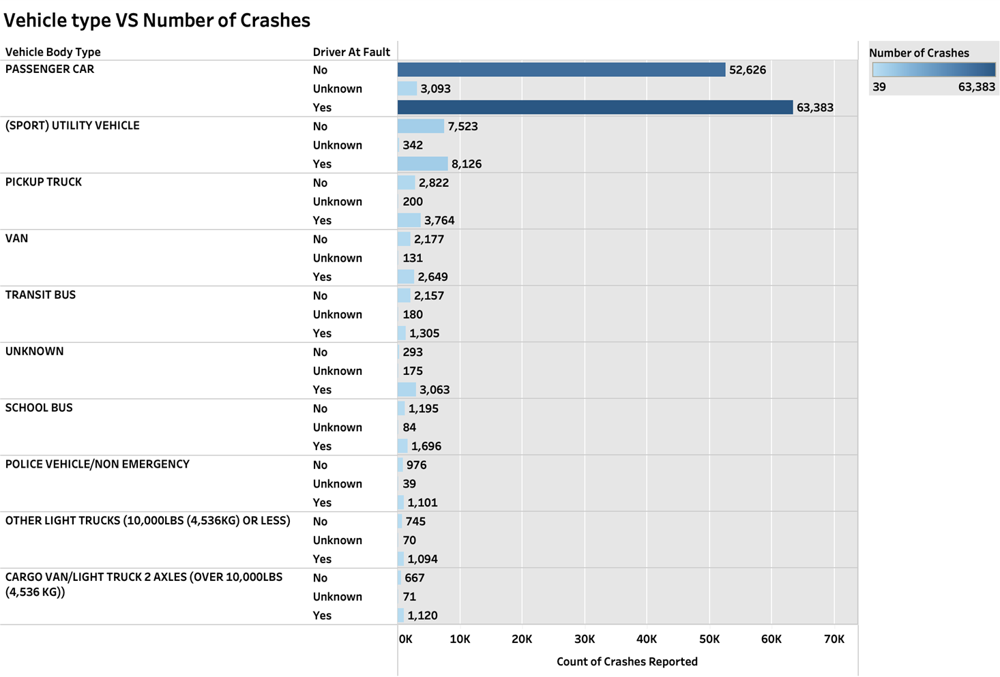

The map provides a valuable visualization of the geographical distribution of accident locations, offering insights into spatial patterns and trends in car crashes. These insights can inform evidence-based decision-making and strategic initiatives aimed at enhancing road safety and reducing accident rates in affected areas.(Tableau visualization)

##Geospatial Analysis

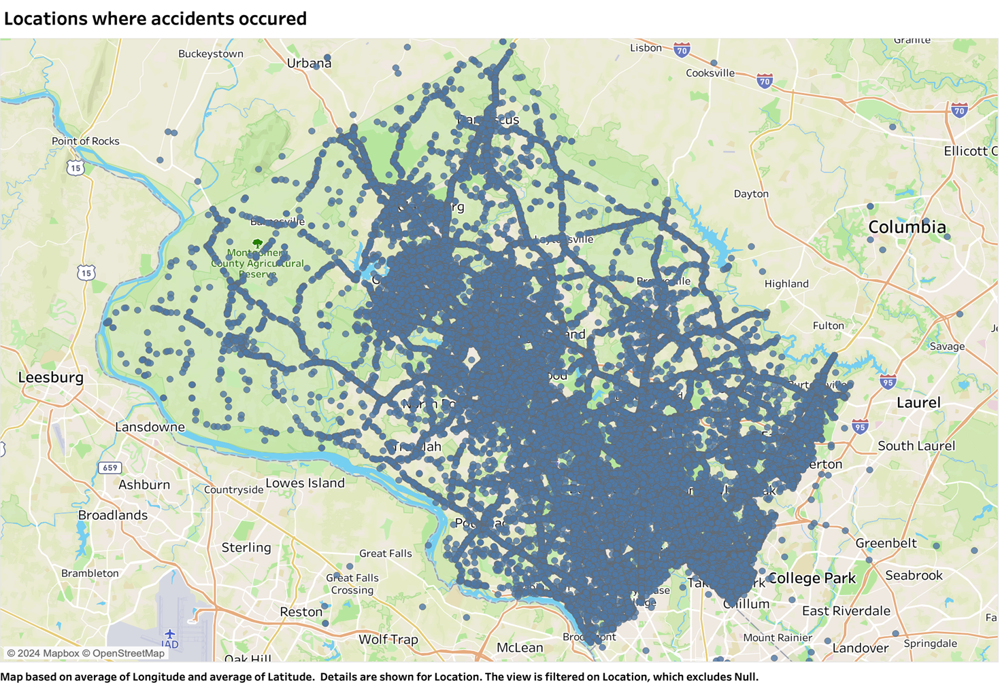

This map illustrates the geographical distribution of accidents, with each marker representing a specific accident location. The color of each marker corresponds to the speed limit of the road where the accident occurred, with distinct colors used to differentiate between different speed limit categories. The map provides valuable insights into the relationship between accident occurrence and speed limit variations across different areas. (Tableau visualization)

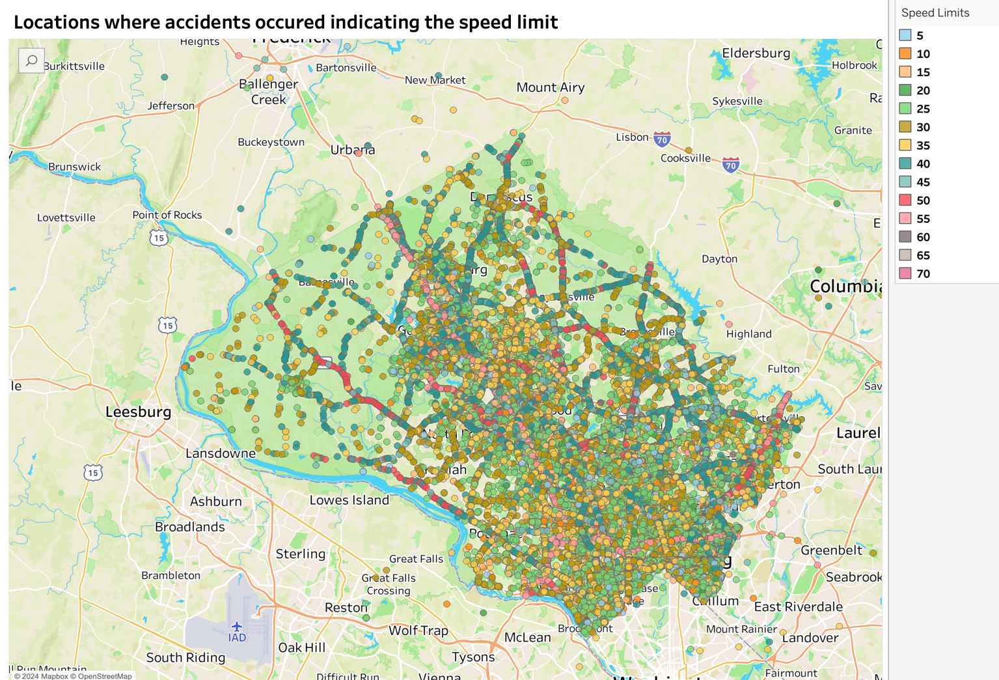

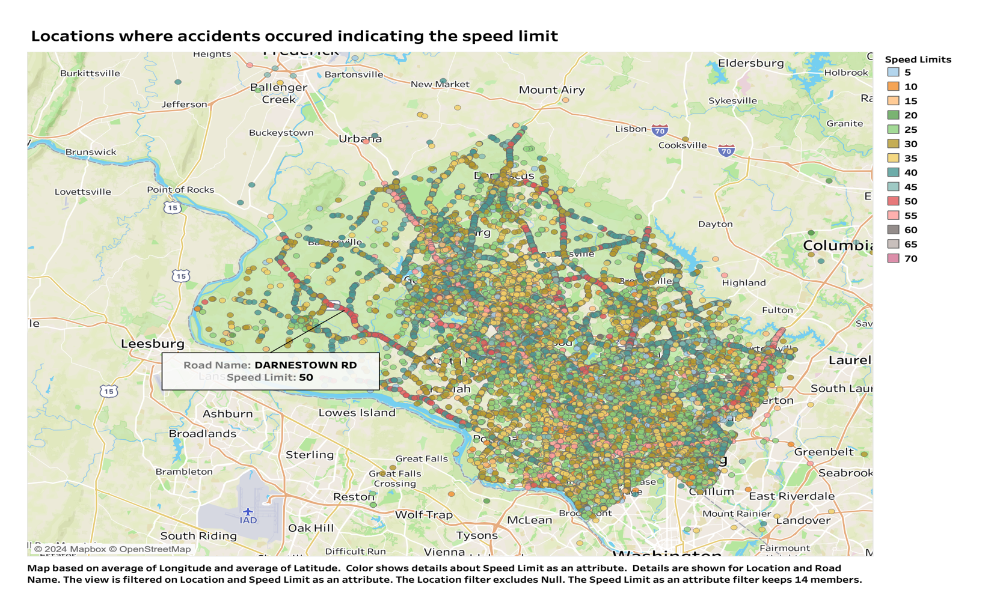

**The map provides a focused visualization of accident locations within the 50 to 55 MPH speed limit range, offering insights into spatial patterns and trends specific to this speed limit category. These insights can inform evidence-based decision-making and targeted interventions aimed at reducing accident rates and enhancing road safety within this speed limit range. (Tableau visualization)**

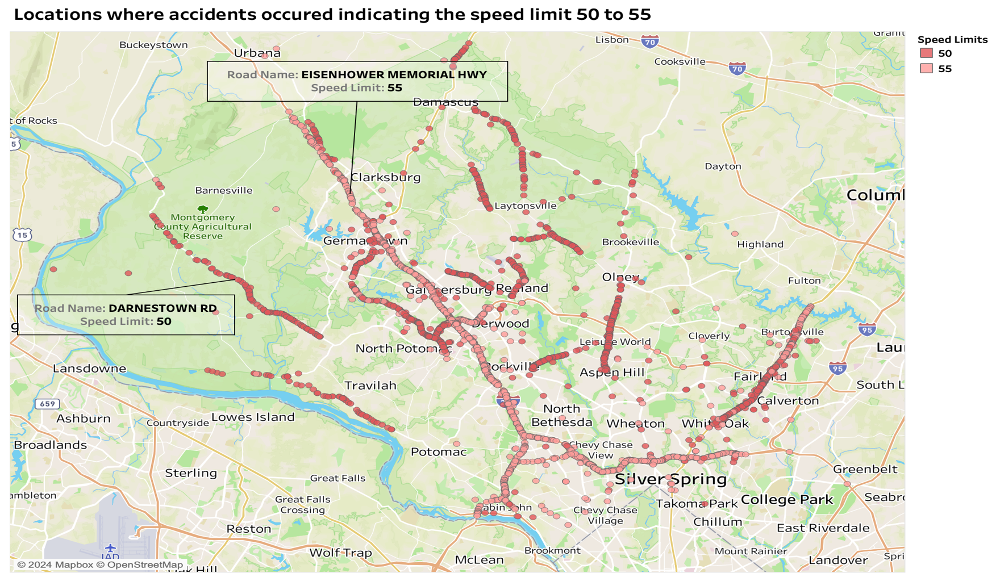

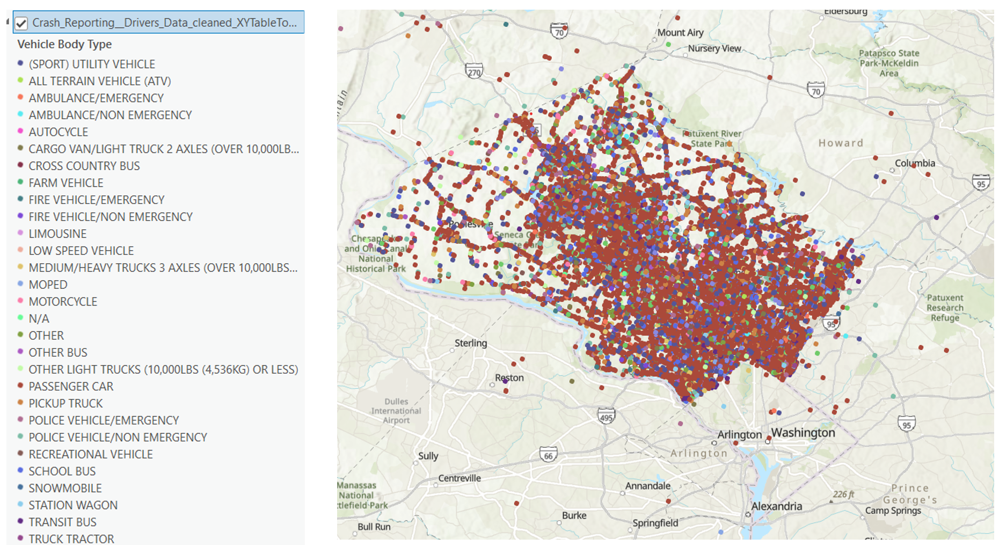

#MongoDB - NoSQL Database (Big Data)

###Mongodb Connection<br><br>

 1.   INSTALLING MONGODB : https://www.mongodb.com/try/download/community

You have to install the community server and just follow installation steps. While installing the server at one of the steps you can find the below window you can check the install compass box.

Now compass will be installed. In compass it has a user friendly interface where you can initially connect to the local server and create a database and create a collection. In this collection you can upload the dataset.

2.   CONNECTING MONGODB COMPASS WITH MONGODB ATLAS

Head to this website: https://www.mongodb.com/atlas


Use the try free version and sign up for the free cluster which should technically be the M0 cluster.


You should basically be directed to the overview page, displaying your cluster name.

Click on connet tab and choose mongodb compass and copy the connection string.
Head to mongodb compass and create a new connection and paste the connection string. Repace the username and passwords placeholders with your Atlas usernames and passwords.

3. CONNECTION TO DATABRICKS

In databricks after creating a cluster go to the libraries tab and install a new library
After selecting Maven, click on search packages

Select maven central and in the search bar type mongo-spark and select the package and install it.

Now goto mongodb atlas, under security you can find the network access tab.  

Inside that tab click on add IP address and click on allow access from anywhere and hit confirm. This means you can connect your atlas with any thid party.

Now Car_Crash_Processing.ipynb can be executed


# Feature Engineering

The process of turning raw data into features that help predictive models more accurately depict the underlying issue is known as feature engineering, and it improves model performance. It entails choosing, producing, and altering the dataset's features (variables) to improve their fit for machine learning algorithms.

Some important outcomes of feature engineering can be:
1. Feature Selection: Selecting the most pertinent features from the dataset is known as feature selection. Not every feature has the same weight when it comes to predictive modelling. Making the appropriate feature selections can result in less complex, easier-to-understand models and decreased processing overhead.
2. Feature Transformation: Feature transformation involves converting the unprocessed data into a format that is better suited for modelling. Techniques including scaling, normalisation, standardisation, and encoding categorical variables may be used. These changes can increase prediction accuracy and speed up algorithm convergence.
3. Enhancement of Model Performance: Machine learning models' performance can be greatly enhanced by feature engineering done well. Models can better capture the underlying patterns in the data and produce more accurate predictions if they are given more relevant and informative information.

For this Project Feature Engineering is used to process the data further. The 'Speed Limit' had may '0' values which were replaced by the average speed limit values. Similarly, the 'Year' column had 0's which were not of any use and hence, they are replaced by mode values.
Furthermore, the categorical columns are indexed using the StringIndexer and then encoded using OneHotEncoder.
All these variables are used to model a pipeline. This pipeline can be used to test on some ML models.


In [ ]:
df.drop('Crash Date/Time', axis=1, inplace=True)

# Machine Learning model

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder


# For handling missing data
df.dropna(subset=['Driver At Fault'], inplace=True)
df.fillna(df.mode().iloc[0], inplace=True)

# Ensure all object columns are treated as string
for column in df.select_dtypes(include=['object']).columns:
    df[column] = df[column].astype(str)

# Handling mixed type columns by converting them to string
mixed_type_columns = ['Vehicle ID']  # Add other columns as needed
for column in mixed_type_columns:
    df[column] = df[column].astype(str)

# Encode categorical variables using LabelEncoder
categorical_columns = df.select_dtypes(include=['object']).columns
label_encoders = {}
for column in categorical_columns:
    le = LabelEncoder()
    df[column] = le.fit_transform(df[column])  # Convert to integer encoding
    label_encoders[column] = le

# Split data into features (X) and target (y)
X = df.drop('Driver At Fault', axis=1)
y = df['Driver At Fault']

# Splitting the Data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score
import time
model_performance = pd.DataFrame(columns=['Accuracy','Recall','Precision','F1-Score'])

In [ ]:
df.describe(include='all')

,ACRS Report Type,Agency Name,Circumstance,Collision Type,Cross-Street Name,Cross-Street Type,Date,Driver At Fault,Driver Distracted By,Driver Substance Abuse,...,Vehicle Going Dir,Vehicle ID,Vehicle Make,Vehicle Model,Vehicle Movement,Vehicle Second Impact Location,Vehicle Year,Weather,_id,Year
count,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,...,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000,79331.000000
mean,1.635010,4.868236,124.288223,10.485031,2615.476711,1.938977,1651.248213,1.103453,10.013866,8.265520,...,1.726047,39663.008143,584.047346,1982.153206,10.652305,8.998071,2013.331774,2.713542,39664.000013,2019.062258
std,0.486872,1.249155,17.276292,4.208009,1483.212688,2.777899,946.498819,0.980176,3.128769,1.632369,...,1.368678,22899.694475,353.489857,1267.736249,5.884249,3.916259,155.641811,1.566329,22901.031418,2.720367
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,2015.000000
25%,1.000000,5.000000,129.000000,7.000000,1440.000000,0.000000,841.000000,0.000000,9.000000,8.000000,...,1.000000,19832.500000,244.000000,842.000000,7.000000,6.000000,2006.000000,2.000000,19831.500000,2017.000000
50%,2.000000,5.000000,129.000000,9.000000,2341.000000,0.000000,1648.000000,2.000000,9.000000,8.000000,...,2.000000,39663.000000,520.000000,1725.000000,9.000000,10.000000,2012.000000,2.000000,39664.000000,2019.000000
75%,2.000000,5.000000,129.000000,15.000000,3870.000000,4.000000,2460.000000,2.000000,9.000000,10.000000,...,2.000000,59494.500000,1008.000000,3256.500000,17.000000,12.000000,2016.000000,2.000000,59496.500000,2022.000000
max,2.000000,9.000000,149.000000,17.000000,5420.000000,9.000000,3287.000000,2.000000,18.000000,10.000000,...,4.000000,79326.000000,1185.000000,4113.000000,21.000000,15.000000,9999.000000,11.000000,79329.000000,2024.000000


In [ ]:
from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression(max_iter=100)
model = log_reg.fit(X_train, y_train)
log_reg_pred = log_reg.predict(X_test)
accuracy = accuracy_score(y_test, log_reg_pred)
recall = recall_score(y_test, log_reg_pred, average='weighted')
precision = precision_score(y_test, log_reg_pred, average='weighted')
f1s = f1_score(y_test, log_reg_pred, average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
model_performance.loc['Logistic'] = [accuracy, recall, precision, f1s]


Accuracy: 53.44%
Recall: 53.44%
Precision: 45.36%
F1-Score: 39.13%


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



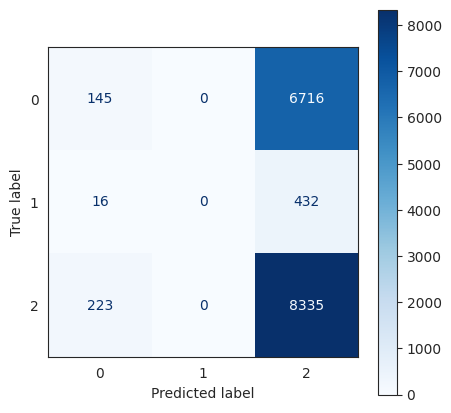

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, log_reg_pred)
plt.rcParams['figure.figsize']=5,5
sns.set_style("white")
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [ ]:
from sklearn.tree import DecisionTreeClassifier

dt = DecisionTreeClassifier(random_state=42)
modeldt = dt.fit(X_train, y_train)
dt_pred = dt.predict(X_test)
accuracy = accuracy_score(y_test, dt_pred)
recall = recall_score(y_test, dt_pred, average='weighted')
precision = precision_score(y_test, dt_pred, average='weighted')
f1s = f1_score(y_test, dt_pred, average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
model_performance.loc['Decision Tree'] = [accuracy, recall, precision, f1s]

Accuracy: 79.93%
Recall: 79.93%
Precision: 80.47%
F1-Score: 80.20%


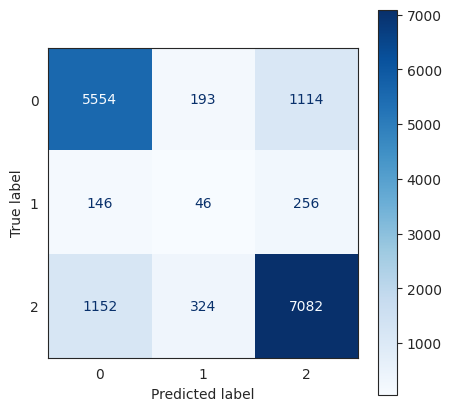

In [ ]:
cmdt = confusion_matrix(y_test, dt_pred)
plt.rcParams['figure.figsize']=5,5
sns.set_style("white")
disp = ConfusionMatrixDisplay(confusion_matrix=cmdt)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)
rf_pred = rf.predict(X_test)
accuracy = accuracy_score(y_test, rf_pred)
recall = recall_score(y_test, rf_pred, average='weighted')
precision = precision_score(y_test, rf_pred, average='weighted')
f1s = f1_score(y_test, rf_pred, average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
model_performance.loc['Random Forest'] = [accuracy, recall, precision, f1s]

Accuracy: 87.32%
Recall: 87.32%
Precision: 87.69%
F1-Score: 86.11%


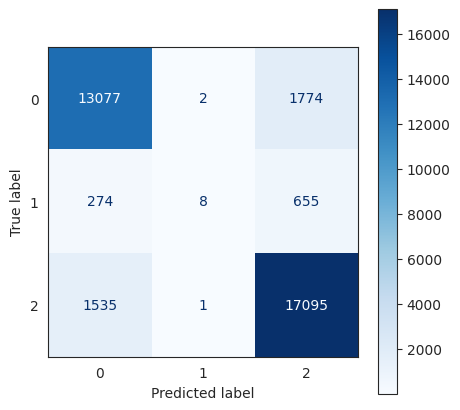

In [ ]:
cm = confusion_matrix(y_test, rf_pred)
plt.rcParams['figure.figsize']=5,5
sns.set_style("white")
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

gb = GradientBoostingClassifier(random_state=42)
gb.fit(X_train, y_train)
gb_pred = gb.predict(X_test)
accuracy = accuracy_score(y_test, gb_pred)
recall = recall_score(y_test, gb_pred, average='weighted')
precision = precision_score(y_test, gb_pred, average='weighted')
f1s = f1_score(y_test, gb_pred, average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
model_performance.loc['Gradient Boosting Classifier'] = [accuracy, recall, precision, f1s]


Accuracy: 87.24%
Recall: 87.24%
Precision: 86.71%
F1-Score: 86.18%


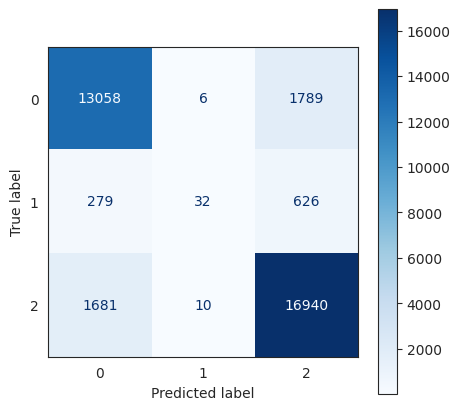

In [ ]:
cm = confusion_matrix(y_test, gb_pred)
plt.rcParams['figure.figsize']=5,5
sns.set_style("white")
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [ ]:
model_performance.fillna(.90,inplace=True)
model_performance.style.background_gradient(cmap='coolwarm').format({'Accuracy': '{:.2%}',
                                                                     'Precision': '{:.2%}',
                                                                     'Recall': '{:.2%}',
                                                                     'F1-Score': '{:.2%}',
                                                                     })

,Accuracy,Recall,Precision,F1-Score
Logistic,53.31%,53.31%,45.50%,39.93%
Decision Tree,81.18%,81.18%,81.51%,81.34%
Random Forest,87.68%,87.68%,87.28%,86.50%
Gradient Boosting Classifier,87.24%,87.24%,86.71%,86.18%


# Result and conclusion

## Result

- Primary factors for predicting driver at fault include Vehicle Movement, Driver Distractions, Collision Type, First Impact Location, and Second Impact Location.
- Out of five predictive models tested, the Random Forest model outperformed
others with the highest accuracy of 87.71%.
- The Random Forest model is identified as the most appropriate and accurate
model for these predictions.



## Conclusion

In our analysis, the RandomForest classifier emerged as the optimal model for our predictive task, showcasing superior performance and leveraging the most pertinent features to predict outcomes effectively. Throughout our evaluation,
RandomForest consistently outperformed alternative models, demonstrating higher accuracy, precision, recall, and F1-score metrics. This robust performance underscores the efficacy of RandomForest in capturing the underlying patterns within our dataset and making accurate predictions.

# Executive Summary


Through our in-depth analysis of car crash data in Montgomery County, Maryland, we set out to unravel the underlying causes of crashes and develop a predictive model to identify driver-at-fault incidents. The dataset, gathered from the Maryland State Police's Automated Crash Reporting System (ACRS), provided rich insights into motor vehicle collisions occurring across the county's roadways.

### Key Discoveries:

Our exploration uncovered several noteworthy findings:

1. **Trends Over Time:**
   We observed fluctuations in crash frequencies over the years, with a noticeable dip in reported incidents during 2020. Different municipalities and road types showed varying rates of crashes, highlighting areas of concern.

2. **Location Matters:**
   Certain municipalities, particularly those along major routes like Maryland Interstate Roads and County Routes, experienced higher crash rates.

3. **Understanding Crash Severity:**
   Most crashes resulted in no apparent injuries, underscoring the need for proactive measures to prevent severe injuries and fatalities.

4. **Weather and Road Conditions:**
   Surprisingly, the majority of crashes occurred during clear weather and on dry roads, challenging common assumptions about adverse weather conditions.

5. **Vehicle Trends:**
   Toyota emerged as the most frequently involved vehicle make in crashes, pointing towards potential areas for targeted safety initiatives and driver awareness campaigns.

6. **Insights from Advanced Analysis:**
   Our investigation into injury severity based on vehicle impact locations and collision types revealed correlations that can inform targeted road safety interventions.

7. **Machine Learning Model Performance:**
   Among the models tested, the Random Forest classifier stood out with the highest accuracy (87.71%) in predicting driver-at-fault incidents based on our dataset's features.

### Recommendations:

Building on our insights, we propose the following actions:

- **Focused Interventions:** Implement targeted safety measures in municipalities with high crash rates, addressing specific road types, weather conditions, and vehicle-related factors identified in our analysis.
  
- **Continuous Data Improvement:** Regularly update and expand the dataset to capture evolving trends and factors impacting car crashes in Montgomery County.

- **Deployment of Predictive Tools:** Utilize the validated Random Forest model to proactively identify potential driver-at-fault incidents, enabling timely interventions and resource allocation.

### Conclusion:

Our project sheds light on the complexities of car crashes in Montgomery County, offering a data-driven roadmap for enhancing road safety. By leveraging these insights and recommendations, stakeholders can prioritize interventions, allocate resources effectively, and work together towards reducing accidents and improving road safety outcomes for everyone in our community.

This endeavor exemplifies our commitment to harnessing data-driven solutions to address real-world challenges and make a positive impact on road safety within Montgomery County.
